In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split

In [2]:
# from ucimlrepo import fetch_ucirepo 
  
# # fetch dataset 
# bank_marketing = fetch_ucirepo(id=222) 
  
# # data (as pandas dataframes) 
# X = bank_marketing.data.features 
# y = bank_marketing.data.targets 
  
# # metadata 
# print(bank_marketing.metadata) 
  
# # variable information 
# print(bank_marketing.variables) 


In [3]:
import requests

url = 'https://archive.ics.uci.edu/static/public/222/data.csv'

request = requests.get(url)
with open("../data/raw/bank-full.csv", 'wb') as f:
        f.write(request.content)

In [4]:
# bank_additional = pd.read_csv('../data/bank-additional/bank-additional-full.csv', sep=';')
# bank = pd.read_csv('../data/bank/bank-full.csv', sep=';')
bank = pd.read_csv('../data/raw/bank-full.csv', sep=',')

In [5]:
# bank_additional

In [6]:
bank.columns

Index(['age', 'job', 'marital', 'education', 'default', 'balance', 'housing',
       'loan', 'contact', 'day_of_week', 'month', 'duration', 'campaign',
       'pdays', 'previous', 'poutcome', 'y'],
      dtype='object')

In [7]:
# bank_additional.columns

In [8]:
# [col for col in bank_additional.columns if col not in bank.columns]

In [9]:
# [col for col in bank.columns if col not in bank_additional.columns]

In [10]:
bank.shape

(45211, 17)

In [11]:
# bank_additional.shape

Dataset `bank_additional` has fewer datapoints and some cols that requires domain knowldage to understand. **We will choose `bank` in this project.**

or we can also load the dataset directly from library

In [12]:
# from ucimlrepo import fetch_ucirepo 
  
# # fetch dataset 
# bank_marketing = fetch_ucirepo(id=222) 
  
# # data (as pandas dataframes) 
# X = bank_marketing.data.features 
# y = bank_marketing.data.targets 
  
# # metadata 
# print(bank_marketing.metadata) 
  
# # variable information 
# print(bank_marketing.variables) 

In [13]:
bank.head()

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,no,2143,yes,no,NaN,5,may,261,1,-1,0,NaN,no
1,44,technician,single,secondary,no,29,yes,no,NaN,5,may,151,1,-1,0,NaN,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,NaN,5,may,76,1,-1,0,NaN,no
3,47,blue-collar,married,NaN,no,1506,yes,no,NaN,5,may,92,1,-1,0,NaN,no
4,33,NaN,single,NaN,no,1,no,no,NaN,5,may,198,1,-1,0,NaN,no


In [14]:
bank.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   age          45211 non-null  int64 
 1   job          44923 non-null  object
 2   marital      45211 non-null  object
 3   education    43354 non-null  object
 4   default      45211 non-null  object
 5   balance      45211 non-null  int64 
 6   housing      45211 non-null  object
 7   loan         45211 non-null  object
 8   contact      32191 non-null  object
 9   day_of_week  45211 non-null  int64 
 10  month        45211 non-null  object
 11  duration     45211 non-null  int64 
 12  campaign     45211 non-null  int64 
 13  pdays        45211 non-null  int64 
 14  previous     45211 non-null  int64 
 15  poutcome     8252 non-null   object
 16  y            45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


In [15]:
bank.y.value_counts()/len(bank)

y
no     0.883015
yes    0.116985
Name: count, dtype: float64

Pay attention that the target is **class-imbalanced**

# global config

In [16]:
pd.set_option('display.max_columns', None)
# pd.set_option('display.max_rows', None)
pd.options.display.float_format = '{:.3f}'.format
random_state = 522

# train test split

In [17]:
bank_train, bank_test = train_test_split(bank
                                        , test_size=0.2
                                        , random_state=random_state
                                        , stratify=bank.y
                                        )

In [18]:
bank_train.y.value_counts()/len(bank_train)

y
no    0.883
yes   0.117
Name: count, dtype: float64

Via stratified split, we managed to keep the distribtuion of the label in the original dataset.

# EDA

In [19]:
for i in list(bank_train.columns):
    print(f"{i:<10}->  {bank_train[i].nunique():<5} unique values")

age       ->  77    unique values
job       ->  11    unique values
marital   ->  3     unique values
education ->  3     unique values
default   ->  2     unique values
balance   ->  6601  unique values
housing   ->  2     unique values
loan      ->  2     unique values
contact   ->  2     unique values
day_of_week->  31    unique values
month     ->  12    unique values
duration  ->  1506  unique values
campaign  ->  47    unique values
pdays     ->  536   unique values
previous  ->  40    unique values
poutcome  ->  3     unique values
y         ->  2     unique values


In [20]:
bank_int = list(bank_train.select_dtypes(include = ['int64']).columns)
bank_str = list(bank_train.select_dtypes(include = ['object']).columns)
# bank_str.remove("y")
bank_categorical = bank_str+['day']

In [21]:
bank_categorical

['job',
 'marital',
 'education',
 'default',
 'housing',
 'loan',
 'contact',
 'month',
 'poutcome',
 'y',
 'day']

# Altair

In [22]:
import altair as alt

alt.data_transformers.disable_max_rows()

charts = []

for i, var in enumerate(bank_categorical):
    if i == 9:  
        break

    num_rows = len(bank_train[var].unique())

    chart = alt.Chart(bank_train).mark_bar(stroke=None).encode(
        x=alt.X('count()', title='Count'),
        y=alt.Y('y:N', title=None),
        color=alt.Color('y:N', scale=alt.Scale(range=['#3C6682', '#45A778'])),
        row=alt.Row(f'{var}:N')
    ).properties(
        width=200,
        height=200 / num_rows,
        title=f'Grouped Bar Plot for {var}',
        spacing=0
    )

    charts.append(chart)

final_chart = alt.concat(*charts, columns=3).configure_axis(grid=False).configure_header(
    labelAngle=0,
    labelAlign='left'
)

final_chart


alt.ConcatChart(...)

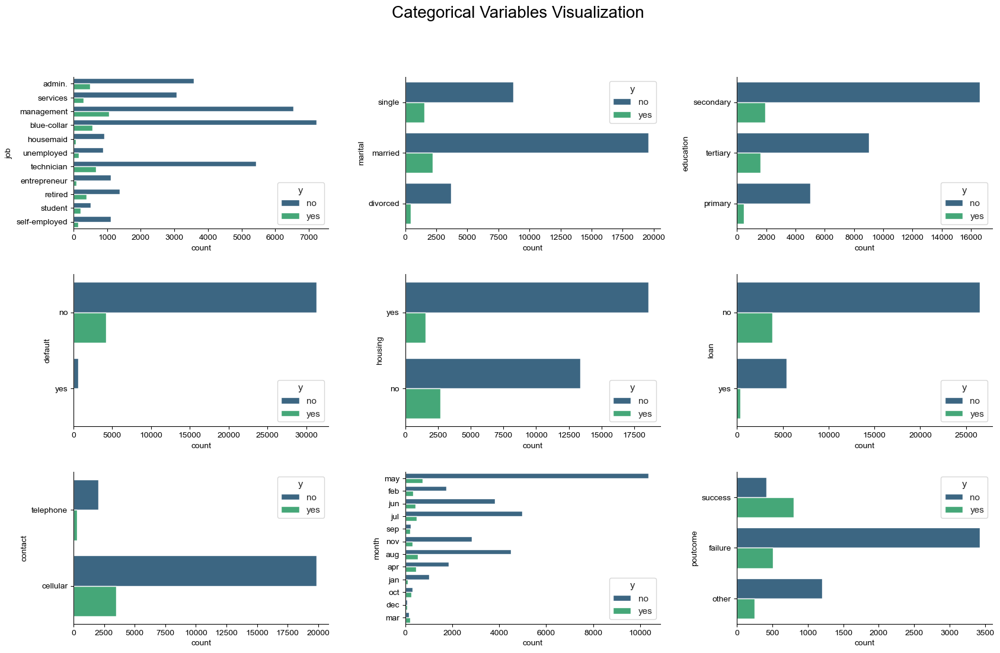

In [23]:
fig, axes = plt.subplots(3, 3, figsize=(20, 12))
plt.suptitle('Categorical Variables Visualization', fontsize=20)
plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.3, hspace=0.3)
for i, ax in enumerate(axes.ravel()):
    if i > 9:
        ax.set_visible(False)
        continue
    sns.set_theme(style="white")
    sns.countplot(y = bank_str[i], data = bank_train, hue='y', ax = ax, palette="viridis")    
    sns.despine()
    
plt.show()

# Altair

In [24]:
bank_continuous = bank_train[bank_int]

charts = []

for i, column in enumerate(bank_continuous.columns):
    hist_chart = alt.Chart(bank_train).mark_bar(opacity=0.7, color='steelblue').encode(
        x=alt.X(f'{column}:Q', bin=alt.Bin(maxbins=50), title=column),
        y=alt.Y('count():Q', stack=None, title='Count'),
    )

    kde_chart = alt.Chart(bank_train).transform_density(
        column,
        as_=[column, 'density'],
    ).mark_line(color='red').encode(
        x=alt.X(f'{column}:Q', title=column),
        y=alt.Y('density:Q', title='Density'),
    )

    chart = alt.layer(hist_chart, kde_chart).resolve_scale(y='independent').properties(
        width=200,
        height=150,
        title=f'{column}'
    )

    charts.append(chart)

final_chart = alt.concat(*charts, columns=3).configure_axis(grid=False)

final_chart

alt.ConcatChart(...)

Continuous Variables Visualization


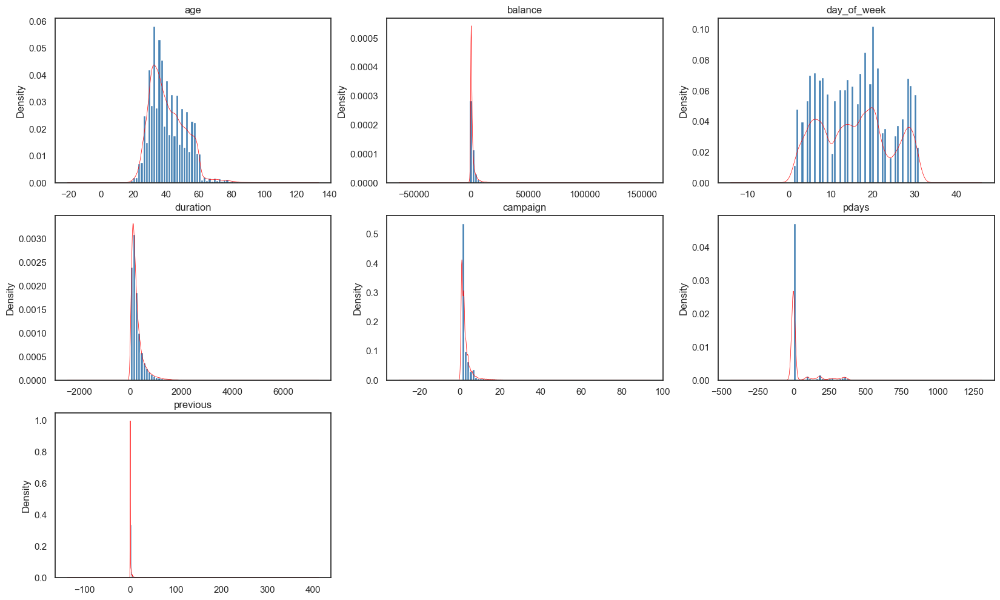

In [25]:
print("Continuous Variables Visualization")
fig, axes = plt.subplots(nrows = 3,ncols = 3,figsize = (20,12))
for i, item in enumerate(bank_int):
    if i < 3:
#         ax = sns.displot(bank[item], bins=100, hist=True, kde=True)
        ax = bank_train[item].plot(kind = 'hist', ax=axes[0,i], bins=50, density=True, color='steelblue')
        ax = bank_train[item].plot(kind = 'kde', ax=axes[0,i], color = 'red', linewidth=0.5)
    elif i >=3 and i < 6:
        ax = bank_train[item].plot(kind = 'hist', ax=axes[1,i-3], bins=50, density=True, color='steelblue')
        ax = bank_train[item].plot(kind = 'kde', ax=axes[1,i-3], color = 'red', linewidth=0.5)
    elif i < 9:
        ax = bank_train[item].plot(kind = 'hist', ax=axes[2,i-6], bins=100, density=True, color='steelblue')
        ax = bank_train[item].plot(kind = 'kde', ax=axes[2,i-6], color = 'red', linewidth=0.5)
        
    ax.set_title(item)
plt.delaxes(axes[2, 1])
plt.delaxes(axes[2, 2])

# Altair

In [26]:
bank_log = ['balance', 'duration', 'campaign', 'pdays', 'previous']
charts = []

for i, column in enumerate(bank_log):
    hist_chart = alt.Chart(bank_train).mark_bar(opacity=0.7, color='steelblue').encode(
        x=alt.X(f'{column}:Q', bin=alt.Bin(maxbins=50), title=column),
        y=alt.Y('count():Q', stack=None, title='Count'),
    )

    kde_chart = alt.Chart(bank_train).transform_density(
        column,
        as_=[column, 'density'],
    ).mark_line(color='red').encode(
        x=alt.X(f'{column}:Q', title=column),
        y=alt.Y('density:Q', title='Density'),
    )

    chart = alt.layer(hist_chart, kde_chart).resolve_scale(y='independent').properties(
        width=200,
        height=150,
        title=f'{column}'
    )

    charts.append(chart)

final_chart = alt.concat(*charts, columns=3).configure_axis(grid=False)

final_chart

alt.ConcatChart(...)

After log transformation


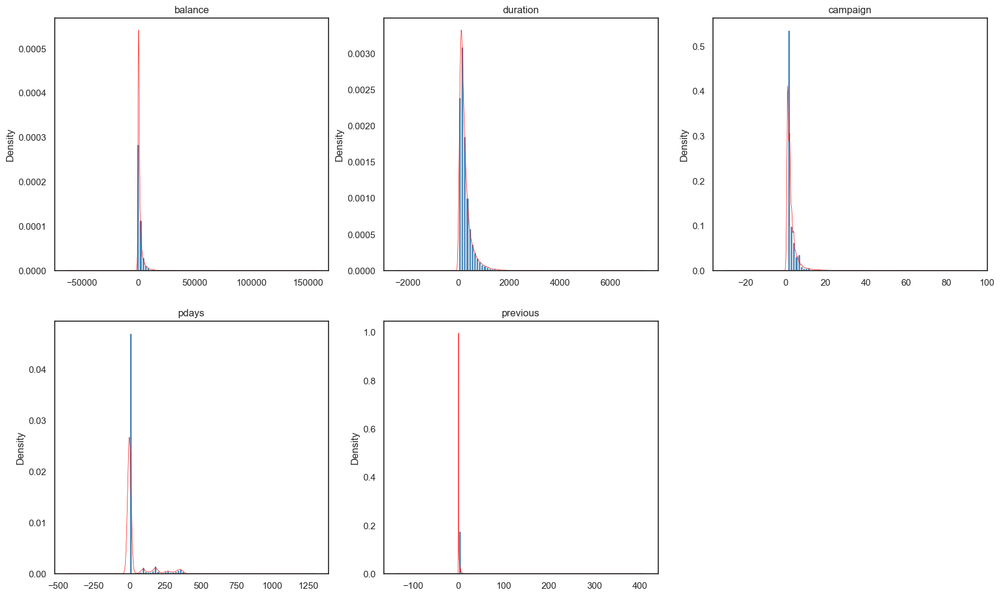

In [27]:
bank_log = ['balance', 'duration', 'campaign', 'pdays', 'previous']
print("After log transformation")
fig, axes = plt.subplots(nrows = 2,ncols = 3,figsize = (20,12))
for i, item in enumerate(bank_log):
    if i < 3:
#         ax = sns.displot(bank[item], bins=100, hist=True, kde=True)
        ax = bank_train[item].plot(kind = 'hist', ax=axes[0,i], bins=50, density=True, color='steelblue')
        ax = bank_train[item].plot(kind = 'kde', ax=axes[0,i], color = 'red', linewidth=0.5)
    elif i >=3 and i < 6:
        ax = bank_train[item].plot(kind = 'hist', ax=axes[1,i-3], bins=50, density=True, color='steelblue')
        ax = bank_train[item].plot(kind = 'kde', ax=axes[1,i-3], color = 'red', linewidth=0.5)
    elif i < 9:
        ax = bank_train[item].plot(kind = 'hist', ax=axes[2,i-6], bins=100, density=True, color='steelblue')
        ax = bank_train[item].plot(kind = 'kde', ax=axes[2,i-6], color = 'red', linewidth=0.5)
        
    ax.set_title(item)
plt.delaxes(axes[1, 2])